<a href="https://colab.research.google.com/github/FlUxIuS/Machine_and_Deep_learning/blob/main/Classifying_a_RFsignal_101.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Classifying a signal 101 by FlUxIuS @Penthertz 

This little Notebook helps you using ML/DL in a simple maner to classify signal.

To begin, let's import some dependencies:

In [ ]:
import matplotlib.pyplot as plt

from scipy import signal
import numpy as np
import scipy as sp
from numpy import save
from sklearn.metrics import accuracy_score, confusion_matrix, recall_score, f1_score, zero_one_loss, classification_report

captures_path = "captures"
modulation_type = "OOK"
sample_name = "arm"

plt.rcParams['figure.dpi'] = 200

After making more than a hundred capture, let's see how we will have to deal with them.

We load a first capture and observe the different properties other the time.

## Starting with an OOK dataset

Let's download the first sample that appears to be OOK:

In [ ]:
!mkdir captures
!wget --no-check-certificate 'https://docs.google.com/uc?export=download&id=1uqBUxiGGxtDSFwMLvPkysjZW08lsEFwU&confirm=t' -O captures/arm_01.cfile

mkdir: cannot create directory ‘captures’: File exists
--2022-06-30 16:01:47--  https://docs.google.com/uc?export=download&id=1uqBUxiGGxtDSFwMLvPkysjZW08lsEFwU&confirm=t
Resolving docs.google.com (docs.google.com)... 173.194.218.100, 173.194.218.101, 173.194.218.102, ...
Connecting to docs.google.com (docs.google.com)|173.194.218.100|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-0c-2k-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/ivfnuccf5p3nk5f1g2hqdif7dg18iif5/1656604875000/05986813251082838440/*/1uqBUxiGGxtDSFwMLvPkysjZW08lsEFwU?e=download&uuid=f671193d-0849-4e67-a627-29b6fde20917 [following]
--2022-06-30 16:01:47--  https://doc-0c-2k-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/ivfnuccf5p3nk5f1g2hqdif7dg18iif5/1656604875000/05986813251082838440/*/1uqBUxiGGxtDSFwMLvPkysjZW08lsEFwU?e=download&uuid=f671193d-0849-4e67-a627-29b6fde20917
Resolving doc-0c-2k-docs.googleusercontent.com

Then observe this signal with Numpy:

/usr/local/lib/python3.7/dist-packages/IPython/core/pylabtools.py:125: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


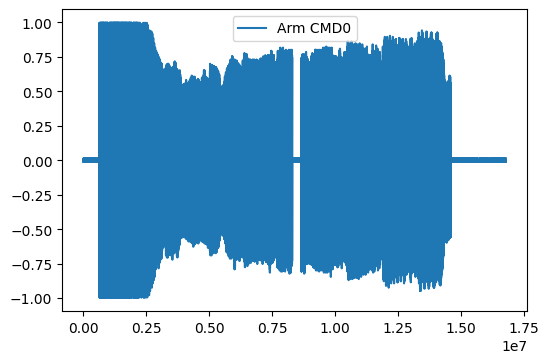

In [ ]:
%matplotlib inline
plt.rcParams['figure.dpi'] = 100
armbutton_01 = np.fromfile(captures_path+"/arm_01.cfile", dtype=np.csingle)
plt.figure()
plt.plot(armbutton_01.real, label="Arm CMD0")
plt.legend()
plt.show()

The signal shape doesn't tell us a lot, so we must zoom a little on it by doing a slice:

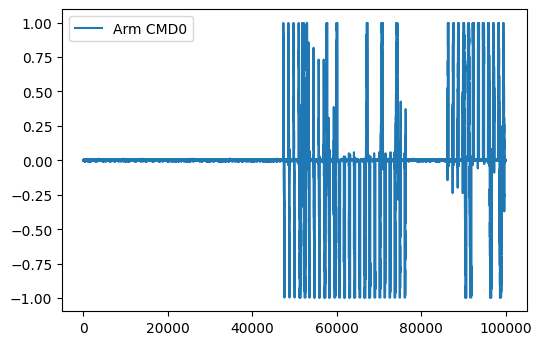

8.3896725


In [ ]:
%matplotlib inline
plt.rcParams['figure.dpi'] = 100
tpower = 1e7
s_begin = 0.06
s_end = 0.07
armbutton_01_slice = armbutton_01[int(s_begin*tpower):int(s_end*tpower)]
plt.figure()
plt.plot(armbutton_01_slice.real, label="Arm CMD0")
plt.legend()
plt.show()
save(captures_path+'/slice_1-armbutton.npy', armbutton_01) # save it into a file
print (len(armbutton_01)/(0.20*1e7))


The displayed signal seems a lot better. It seems like we have peaks of amplitude going up and down like ASK/OOK use to do.

But if we want to automate an analysis, we must find some properties that can be used as features here:
* Zero Crossing Rate
* Mel-Frequency Cepstral Coefficients (even if applied to sound)
* Roll-Off Point (even if applied to sound)
* Number of peaks
* Spectral Centroid
* etc.


# Features we can extract

Let us see some quick features we can extract with Numpy directlly out of our IQs.

## ZCR : Zero Crossing Rate

35720


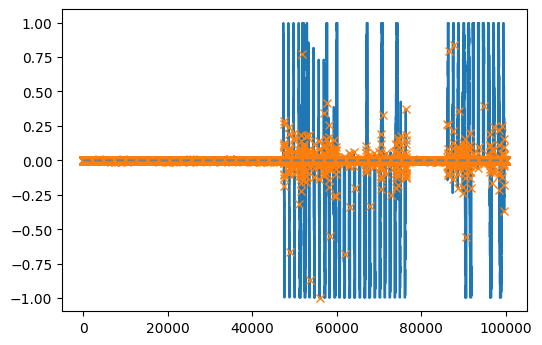

In [ ]:
x = armbutton_01_slice.real
zero_crossings = np.where(np.diff(np.sign(x)))[0]
print (len(zero_crossings))
plt.plot(x)
plt.plot(zero_crossings, x[zero_crossings], "x")
plt.plot(np.zeros_like(x), "--", color="gray")
plt.show()

## Number of peaks

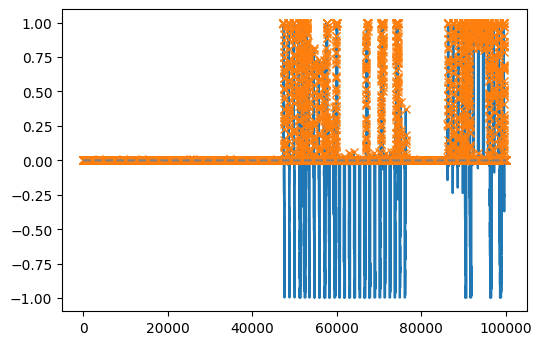

In [ ]:
from scipy.signal import find_peaks
x = armbutton_01_slice.real
peaks, _ = find_peaks(x, height=0.0)
#print(np.diff(peaks))
plt.plot(x)
plt.plot(peaks, x[peaks], "x")
plt.plot(np.zeros_like(x), "--", color="gray")
plt.show()

## Centroid

In [ ]:
x = armbutton_01_slice.real

def spectral_centroid(rsignal, samplerate=1e6):
    magnitudes = np.abs(np.fft.rfft(rsignal))
    length = len(rsignal)
    freqs = np.abs(np.fft.fftfreq(length, 1.0/samplerate)[:length//2+1])
    magnitudes = magnitudes[:length//2+1]
    return np.sum(magnitudes*freqs) / np.sum(magnitudes) 

spectral_centroid(x)

102043.17622526975

## Features list
This will probably need more feature extraction, but looks like a good beginning to make some classification:

In [ ]:
import pandas as pd

x = armbutton_01_slice.real

column_names = ['zcr', 'spectral_c', 'peaks' , 'label']
df = pd.DataFrame(columns = column_names)

def get_features(csignal, label):
    peaks, _ = find_peaks(x, height=0.0)
    return (len(np.where(np.diff(np.sign(csignal)))[0]), spectral_centroid(csignal), len(np.diff(peaks)), label)
    
df.loc[0] = get_features(x, "OOK")
df.head()

,zcr,spectral_c,peaks,label
0,35720,102043.176225,18980,OOK


## Split in slices

Now we will split the capture to several slices for training purposes:

In [ ]:
def capture2slices(capture, start, bandw, category, name, scapower=1e7, stop=None):
    import os
    out_slices = []
    s_begin = start
    s_end = s_begin + bandw
    num_slices = int(len(capture)/(bandw*scapower))
    finalpath = captures_path+'/'+category
    filepath = finalpath+'/'+name
    try:
        os.mkdir(finalpath)
    except Exception as e:
        print (e)
    count = 0
    y_p = 0 # positions
    x_p = 0
    if stop is not None:
        num_slices = stop
    
    rows = int(num_slices/4)
    if num_slices/4 > rows*1.0:
        rows += 1
    fig, axs = plt.subplots(rows, 4, figsize=(18,8 ))
    for count in range(num_slices):
        capture_slice = capture[int(s_begin*scapower):int(s_end*scapower)]
        axs[x_p, y_p].plot(capture_slice.real)
        supername = "%i_%s-%s-%.2f_%.2f" % (count,category, name, s_begin, s_end)
        axs[x_p, y_p].set_title(supername)
        s_begin = s_end
        s_end = s_end + bandw
        if ((y_p % 3) == 0) and (y_p != 0): # increment y and reset x
            y_p = 0
            x_p += 1
        else:
            y_p +=1
        if stop is not None:
            if count >= stop:
                break
            
        out_slices.append(capture_slice)
        save(finalpath+'/'+supername+'.npy', capture_slice)
        
    #plt.rcParams['figure.figsize'] = [22, 16]
    plt.rcParams['figure.dpi'] = 100
    fig.tight_layout()        
    #plt.savefig(filepath+'.png')
    return out_slices

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations


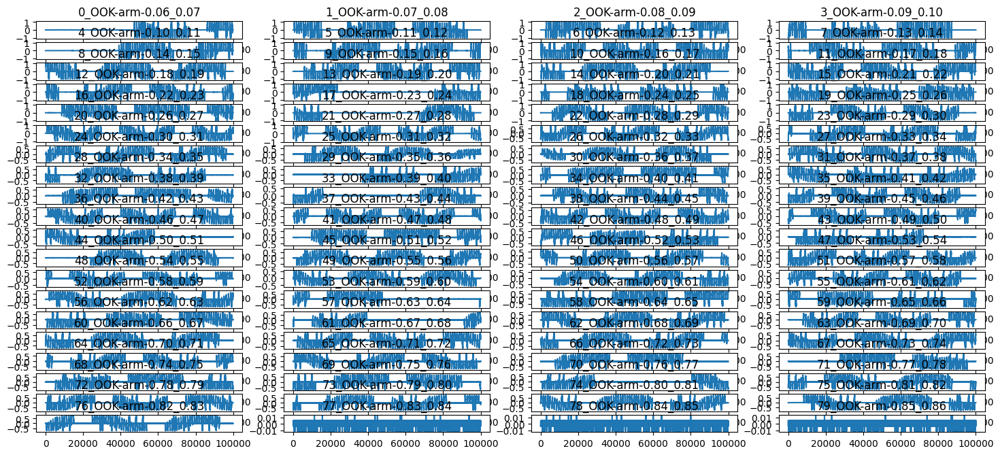

In [ ]:
all_slices = capture2slices(armbutton_01, 0.06, 0.07-0.06, modulation_type, sample_name, stop=80)

This give us several shapes with different level of amplitude.

Let's now get features for all them:

In [ ]:
df = pd.DataFrame(columns = column_names)
count = 0
for tslice in all_slices:
    df.loc[count] = get_features(tslice.real, "OOK")
    count += 1
df.head(40)

,zcr,spectral_c,peaks,label
0,35720,102043.176225,18980,OOK
1,31570,112136.896603,18980,OOK
2,30196,104925.260302,18980,OOK
3,31894,107870.609573,18980,OOK
4,35140,107022.365464,18980,OOK
5,31257,106172.448807,18980,OOK
6,29946,108299.517874,18980,OOK
7,31224,106972.528967,18980,OOK
8,30409,106918.584870,18980,OOK
9,31027,104921.485225,18980,OOK


We can try to show the correlation, but for now it will not give us much information:

Text(0.5, -0.15, 'Super simple correlation matrix')

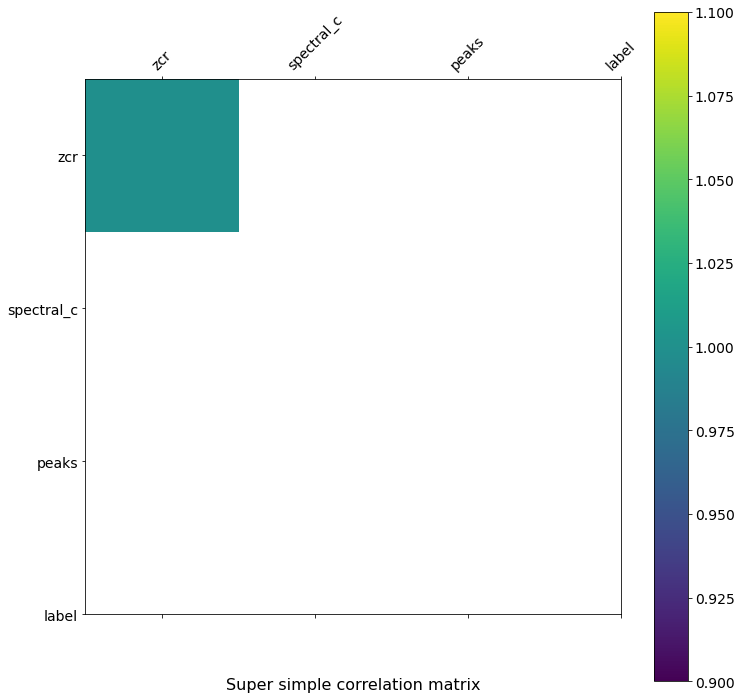

In [ ]:
%matplotlib inline
f = plt.figure(figsize=(12, 12))

plt.matshow(df.corr(), fignum=f.number)
plt.xticks(range(df.shape[1]), df.columns, fontsize=14, rotation=45)
plt.yticks(range(df.shape[1]), df.columns, fontsize=14)

cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Super simple correlation matrix', fontsize=16, y=-0.15)

## Cleaning the signal

Now we need to clean the signal from noise a little, so the ML or DL stage can focuse on our signal only.

So first, we try to find all components in order to apply the good filter:

In [ ]:
def plotFFT(signal, sample_rate=1e6):
    # How many time points are needed i,e., Sampling Frequency
    samplingFrequency   = sample_rate;

    # At what intervals time points are sampled
    samplingInterval       = 1 / samplingFrequency;

    # Frequency domain representation
    fourierTransform = np.fft.fft(armbutton_01)/len(armbutton_01)           # Normalize amplitude
    fourierTransform = fourierTransform[range(int(len(armbutton_01)/2))] # Exclude sampling frequency
    
    tpCount     = len(armbutton_01)
    values      = np.arange(int(tpCount/2))
    timePeriod  = tpCount/samplingFrequency
    frequencies = values/timePeriod

    plt.plot(frequencies, abs(fourierTransform))
    plt.show()

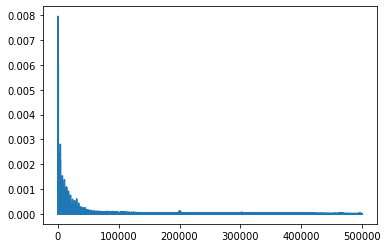

In [ ]:
plotFFT(all_slices[0])

We can see the signal seems to be center, to we will only need a LP filter to clean everything around:

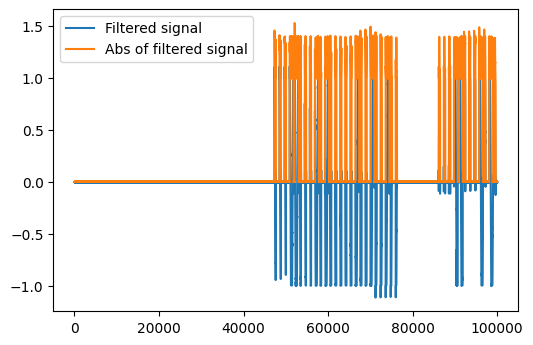

In [ ]:
%matplotlib inline

from scipy.signal import butter, lfilter

plt.rcParams['figure.dpi'] = 100

bandpass_start = 0.001#280e3
bandpass_end = 100e3
bandpass_order = 4
sampling_rate = 1e6

cutoff = 100e3

def apply_bandpass(s, fs, order=bandpass_order, low=bandpass_start, high=bandpass_end):
    b, a = signal.butter(order, [low, high], btype='band', fs=fs)
    zi = signal.lfilter_zi(b, a)
    z, _ = signal.lfilter(b, a, s, zi=zi*s[0])
    return z

# extra based on DelfStack
def apply_lowpass(s, fs, cutoff=100e3, order=4):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    y = lfilter(b, a, s)
    return y

plt.figure()
plt.plot(apply_lowpass(all_slices[0], sampling_rate).real, label="Filtered signal")
#plt.plot(apply_bandpass(all_slices[0], sampling_rate).real, sampling_rate, label="Filtered signal")
plt.plot()
plt.plot(np.abs(apply_lowpass(all_slices[0], sampling_rate)).real, label="Abs of filtered signal")
#plt.plot(np.abs(apply_bandpass(all_slices[0], sampling_rate)).real, label="Abs of filtered signal")
plt.legend()
plt.show()

We display here the signal cleaned and the abs version. But as we can see, the cleaned original signal will be more helpful for the next to come in DL.

For the DL part, we will create a reshaped image by normalizing the image of each slice sample:

array([[0.49960332, 0.49955402, 0.49942946, ..., 0.50026905, 0.50023857,
        0.50001538],
       [0.49948209, 0.49869965, 0.49793254, ..., 0.500501  , 0.5007422 ,
        0.50091863],
       [0.50096346, 0.50079651, 0.50035041, ..., 0.49781078, 0.49807609,
        0.49853196],
       ...,
       [0.09987714, 0.09743989, 0.09865619, ..., 0.49857056, 0.49845931,
        0.49857517],
       [0.49873667, 0.49880233, 0.49871517, ..., 0.73648897, 0.73210112,
        0.72965151],
       [0.72730904, 0.72383721, 0.71984989, ..., 0.49994101, 0.50033342,
        0.50044263]])

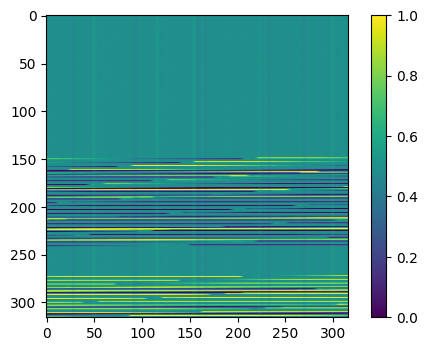

In [ ]:
proc_sample = all_slices[0]

def normalizeImg(csignal, showplot=True, forcesize=None):
    import math
    from sklearn.preprocessing import MinMaxScaler

    # Preprocessing pipeline
    scaler = MinMaxScaler()
    plt.rcParams['figure.dpi'] = 100

    numsamps = int(math.sqrt(len(csignal)))
    if forcesize is not None:
        numsamps = forcesize
    data = apply_lowpass(csignal[:numsamps*numsamps], sampling_rate).real
    #data = apply_bandpass(proc_sample[:numsamps*numsamps]).real 
    #data = np.abs(apply_bandpass(csignal[:numsamps*numsamps])).real
    
    data = np.reshape(data, (numsamps, numsamps))

    # Normalized image
    data = scaler.fit_transform(np.reshape(data, (numsamps, numsamps)))
    if showplot is True:
        plt.figure()
        plt.imshow(data)
        plt.colorbar()
        plt.grid(False)
    return data
    
    
def plotSpectrogram(csignal):
    # Spectrogram
    f, t, Sxx = signal.spectrogram(csignal, 1e6)
    plt.pcolormesh(t, f, Sxx, shading='gouraud')
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
    plt.show()
    
normalizeImg(proc_sample.real)

Displaying the plot, we can clearly see some straight lines reminding us the change of amplitude level.

We can also plot a spectromgram to get an idea of our signal shape over the time:

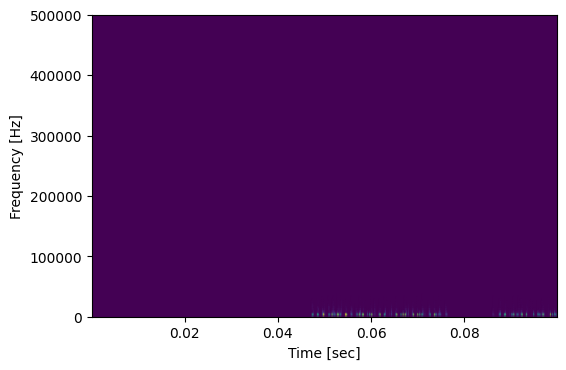

In [ ]:
plotSpectrogram(proc_sample.real)

## Case of FSK

Now we can go to the next set of data that are the FSK packets.

We first download the samples:

In [ ]:
!mkdir captures
!wget --no-check-certificate 'https://docs.google.com/uc?export=download&id=1hz8YDtx9hpPwTjL83JCB64CogOOEceBb&confirm=t' -O captures/fsk.cfile

mkdir: cannot create directory ‘captures’: File exists
--2022-06-30 16:03:10--  https://docs.google.com/uc?export=download&id=1hz8YDtx9hpPwTjL83JCB64CogOOEceBb&confirm=t
Resolving docs.google.com (docs.google.com)... 173.194.218.102, 173.194.218.101, 173.194.218.139, ...
Connecting to docs.google.com (docs.google.com)|173.194.218.102|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-00-2k-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/6mci5ldv96endrnp97g2d8o4djjqgd46/1656604950000/05986813251082838440/*/1hz8YDtx9hpPwTjL83JCB64CogOOEceBb?e=download&uuid=22b84f7a-d3dd-405f-a41b-72aa7e53d38f [following]
--2022-06-30 16:03:10--  https://doc-00-2k-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/6mci5ldv96endrnp97g2d8o4djjqgd46/1656604950000/05986813251082838440/*/1hz8YDtx9hpPwTjL83JCB64CogOOEceBb?e=download&uuid=22b84f7a-d3dd-405f-a41b-72aa7e53d38f
Resolving doc-00-2k-docs.googleusercontent.com

Then as before, we display it to see how we are going to manipulate them:

/usr/local/lib/python3.7/dist-packages/IPython/core/pylabtools.py:125: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


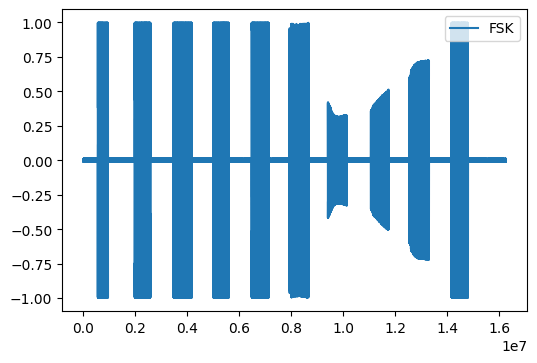

In [ ]:
%matplotlib inline
plt.rcParams['figure.dpi'] = 100
fsksignal = np.fromfile(captures_path+"/fsk.cfile", dtype=np.csingle)
plt.figure()
plt.plot(fsksignal.real, label="FSK")
plt.legend()
plt.show()

And we split them to slice to get the exact number of slices as for the OOK:

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations


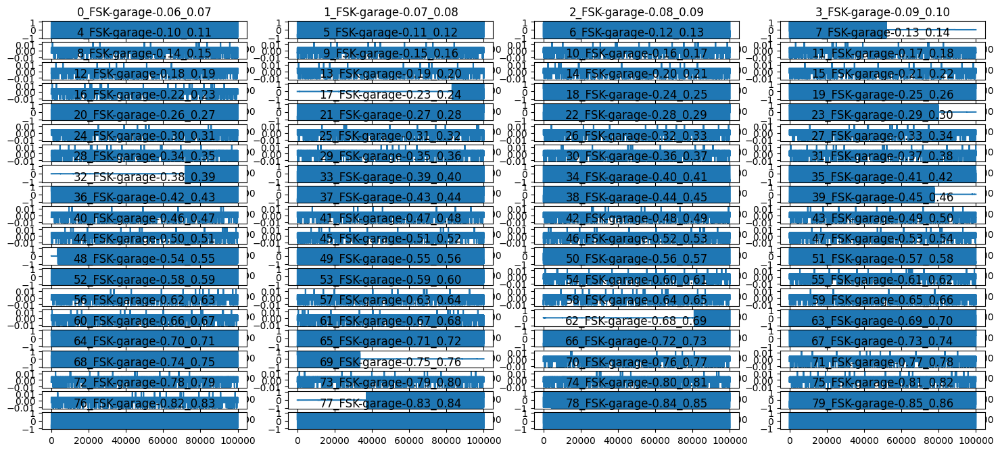

In [ ]:
all_slices_fsk = capture2slices(fsksignal, 0.06, 0.07-0.06, "FSK", "garage", stop=80)

We can quickly get an overview of image features compare to OOK:

array([[0.49569872, 0.4860436 , 0.45791361, ..., 0.07562621, 0.0595731 ,
        0.04448859],
       [0.02984806, 0.01965975, 0.00917769, ..., 0.99846465, 0.99916243,
        0.99782403],
       [0.99101667, 0.98736135, 0.9892935 , ..., 0.79496554, 0.77242233,
        0.74881357],
       ...,
       [0.5746313 , 0.53592589, 0.49753291, ..., 0.8432899 , 0.87128918,
        0.89754288],
       [0.91672499, 0.93532638, 0.95492822, ..., 0.07079687, 0.05042234,
        0.03315093],
       [0.01925342, 0.01202154, 0.00532439, ..., 0.05224394, 0.07071538,
        0.09054824]])

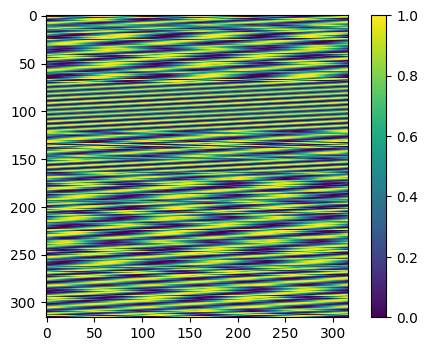

In [ ]:
normalizeImg(all_slices_fsk[1].real)

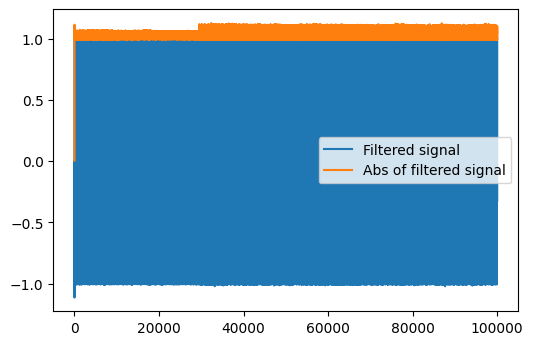

In [ ]:
plt.rcParams['figure.dpi'] = 100

sampling_rate = 1e6

plt.figure()
plt.plot(apply_lowpass(all_slices_fsk[0], sampling_rate).real, label="Filtered signal")
#plt.plot(apply_bandpass(all_slices[0], sampling_rate).real, sampling_rate, label="Filtered signal")
plt.plot()
plt.plot(np.abs(apply_lowpass(all_slices_fsk[0], sampling_rate)).real, label="Abs of filtered signal")
#plt.plot(np.abs(apply_bandpass(all_slices[0], sampling_rate)).real, label="Abs of filtered signal")
plt.legend()
plt.show()

## Machine Learning

For the ML part, we will take the features of each slice and assign a label

In [ ]:
df = pd.DataFrame(columns = column_names)
count = 0
for tslice in all_slices:
    df.loc[count] = get_features(tslice.real, "OOK")
    count += 1
    
for tslice in all_slices_fsk:
    df.loc[count] = get_features(tslice.real, "FSK")
    count += 1
df.head(80)

,zcr,spectral_c,peaks,label
0,35720,102043.176225,18980,OOK
1,31570,112136.896603,18980,OOK
2,30196,104925.260302,18980,OOK
3,31894,107870.609573,18980,OOK
4,35140,107022.365464,18980,OOK
...,...,...,...,...
75,30960,102723.926236,18980,OOK
76,31113,103358.810480,18980,OOK
77,43174,245044.480417,18980,OOK
78,43078,245465.655869,18980,OOK


The correlation matrix is now updated highlighting us that features are not so well correlatated but only ZRC looks okayish... (maybe new more feature would be more helpful):

Text(0.5, -0.15, 'Super simple correlation matrix')

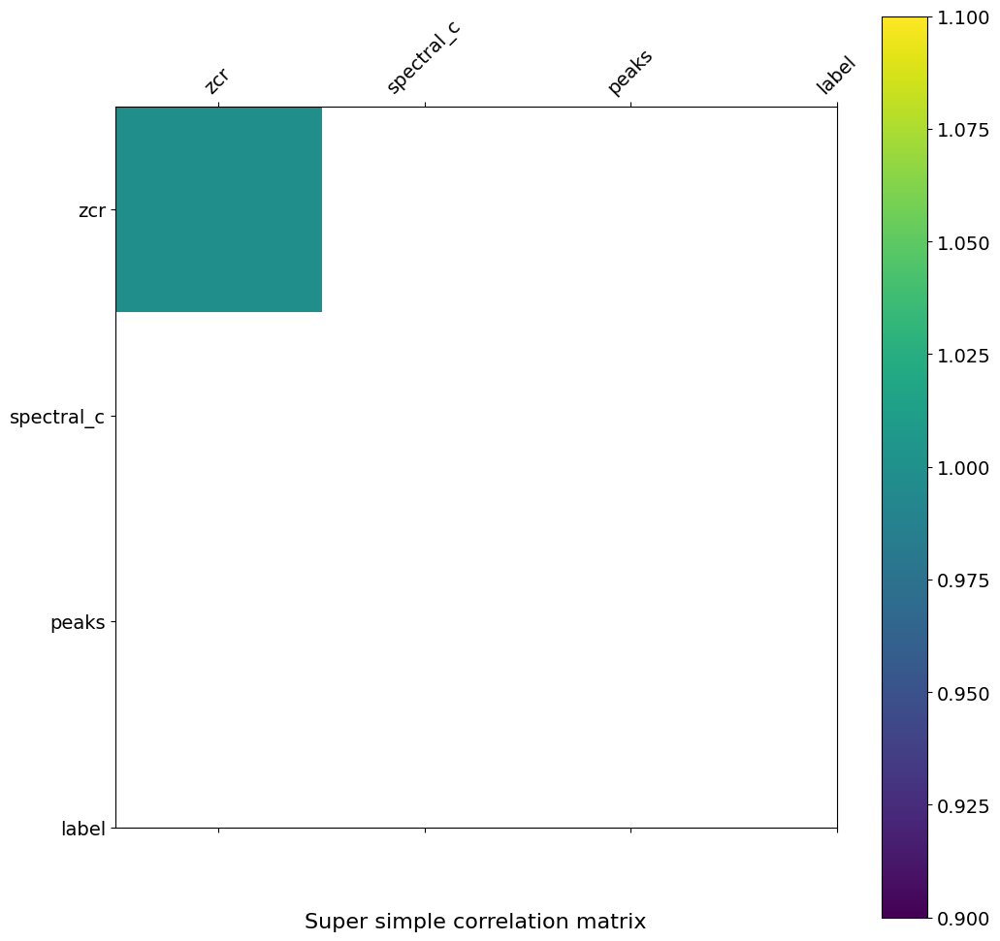

In [ ]:
f = plt.figure(figsize=(12, 12))

plt.matshow(df.corr(), fignum=f.number)
plt.xticks(range(df.shape[1]), df.columns, fontsize=14, rotation=45)
plt.yticks(range(df.shape[1]), df.columns, fontsize=14)

cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Super simple correlation matrix', fontsize=16, y=-0.15)

## Building training samples

We can now build our training sample using the `train_test_split` that will automatically split the data set to training and test set without problems:

In [ ]:
from sklearn.model_selection import train_test_split

X = df[['zcr', 'spectral_c', 'peaks']]
y = df['label']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2)

## SVM implementation

One of the algorithm we can use for classification purpose is the SVM that can be implemented as follows:

Train score :  0.9453125
Test score :  1.0


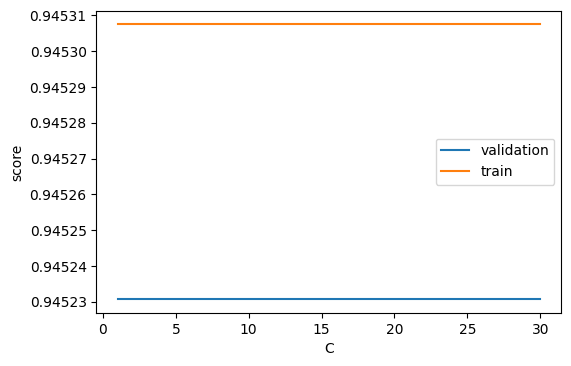

In [ ]:
from sklearn.svm import SVC
from sklearn.model_selection import validation_curve
model_svm = SVC()
model_svm.fit(X_train, y_train)

print('Train score : ', model_svm.score(X_train,y_train))
print('Test score : ', model_svm.score(X_test,y_test))

k_3 = np.arange(1,31)
tr_score_3, val_score_3 = validation_curve(model_svm, X_train, y_train, param_name='C', param_range=k_3, cv = 5)

#5 splits sets de cross validation, on fait la moyenne des scores obtenus sur chacun des 5 splits

train = model_svm.predict(X_train)
predictions = model_svm.predict(X_test)

plt.plot(k_3, val_score_3.mean(axis = 1), label = 'validation')
plt.plot(k_3, tr_score_3.mean(axis = 1), label = 'train')

plt.ylabel('score')
plt.xlabel('C')
plt.legend()

The score looks very promising, even too much promising => we are overfitting and need more data, more classes, etc. But the implementations are still a good start.

## Confusion matrix

Text(122.75000000000001, 0.5, 'predicted label')

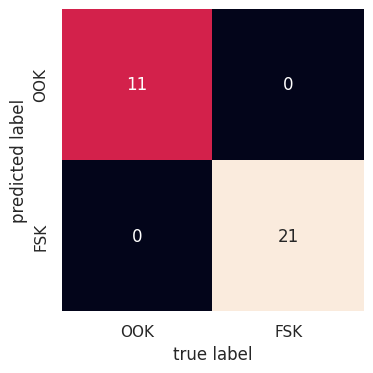

In [ ]:
import seaborn as sns
np.max(val_score_3.mean(axis = 1))
np.argmax(val_score_3.mean(axis = 1)) + 1

#+1 optimal neighbors (https://larevueia.fr/machine-learning-pour-la-classification-automatique-de-musiques-avec-python/)

sns.set()
mat = confusion_matrix(y_test, model_svm.predict(X_test))
sns.heatmap(mat.T, square=True, annot=True, fmt='d', cbar=False, xticklabels=["OOK", "FSK"], yticklabels=["OOK", "FSK"])
plt.xlabel('true label')
plt.ylabel('predicted label')

## Random forest


For this contexte, SVM and k-nn are not super adapted. Better usr Random forest and XGBoost.

To do so, we build a new training set:

In [ ]:
# Readapted from https://larevueia.fr/machine-learning-pour-la-classification-automatique-de-musiques-avec-python/
from sklearn.preprocessing import normalize, StandardScaler

features = df
labels = np.array(features['label'])
features = features.drop('label', axis = 1)
feature_list = list(features.columns)
features = np.array(features)


train_features, test_features, train_labels, test_labels = train_test_split(features, labels, test_size = 0.25, random_state = 0)
print('Training Features Shape:', train_features.shape)
print('Training Labels Shape:', train_labels.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)

sc = StandardScaler()
train_features = sc.fit_transform(train_features)
test_features = sc.transform(test_features)

Training Features Shape: (120, 3)
Training Labels Shape: (120,)
Testing Features Shape: (40, 3)
Testing Labels Shape: (40,)


We try to see what parameter we can actually change:

In [ ]:
from sklearn.ensemble import RandomForestClassifier 
rf = RandomForestClassifier(random_state = 0)
from pprint import pprint
print('Parameters currently in use:\n')
pprint(rf.get_params())

Parameters currently in use:

{'bootstrap': True,
 'ccp_alpha': 0.0,
 'class_weight': None,
 'criterion': 'gini',
 'max_depth': None,
 'max_features': 'auto',
 'max_leaf_nodes': None,
 'max_samples': None,
 'min_impurity_decrease': 0.0,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'min_weight_fraction_leaf': 0.0,
 'n_estimators': 100,
 'n_jobs': None,
 'oob_score': False,
 'random_state': 0,
 'verbose': 0,
 'warm_start': False}


We will play with the number of trees, leafs, and different number of samples:

In [ ]:
# number of trees
n_estimators = [500, 1000, 2000, 3000, 4000, 5000]
# depth
max_depth = [20]
max_depth.append(None)
# min number of simple for a node
min_samples_split = [2, 4]#[2]
# min sample for a leaf
min_samples_leaf = [1, 2]#[1]

# making a grid
random_grid = {'n_estimators': n_estimators,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
              }
pprint(random_grid)

{'max_depth': [20, None],
 'min_samples_leaf': [1, 2],
 'min_samples_split': [2, 4],
 'n_estimators': [500, 1000, 2000, 3000, 4000, 5000]}


After that, a random search allows to have better idea of optimal values, but only on 3 blocs and 10 combinations:

In [ ]:
from sklearn.model_selection import train_test_split, GridSearchCV, validation_curve, RandomizedSearchCV
# making the model
rf = RandomForestClassifier(random_state = 0, max_features = 'sqrt', bootstrap = True)

# random search
rf_random = RandomizedSearchCV(estimator = rf, param_distributions = random_grid, n_iter = 10, cv = 3, verbose=2, random_state=0, n_jobs = -1)

# fit the model
rf_random.fit(train_features, train_labels)

pd_res = pd.concat([pd.DataFrame(rf_random.cv_results_["params"]),pd.DataFrame(rf_random.cv_results_["mean_test_score"], columns=["Accuracy"])],axis=1)
pd_res = pd_res.sort_values('Accuracy', ascending=False)
print(rf_random.best_params_)
pd_res.head(5)

Fitting 3 folds for each of 10 candidates, totalling 30 fits
{'n_estimators': 5000, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': None}


,n_estimators,min_samples_split,min_samples_leaf,max_depth,Accuracy
0,5000,2,1,NaN,0.933333
1,4000,2,1,20.0,0.933333
2,2000,2,1,NaN,0.933333
3,500,4,1,NaN,0.933333
4,2000,4,1,NaN,0.933333


The accuracy here is pretty high for 4000 trees, so it would be better to use that instead of 5000 for performance reasons.

In [ ]:
param_grid = {
    'max_depth': [20, None],
    'min_samples_split': [2],
    'n_estimators': [500, 4000]
}
pprint(param_grid)

{'max_depth': [20, None], 'min_samples_split': [2], 'n_estimators': [500, 4000]}


In [ ]:
# making the RF model
rf = RandomForestClassifier(random_state = 0, bootstrap=True)

# grid search
grid_search = GridSearchCV(estimator = rf, param_grid = param_grid, cv = 3, n_jobs = -1, verbose = 2)

grid_search.fit(train_features, train_labels)

pd_res = pd.concat([pd.DataFrame(grid_search.cv_results_["params"]),pd.DataFrame(grid_search.cv_results_["mean_test_score"], columns=["Accuracy"])],axis=1)
pd_res = pd_res.sort_values('Accuracy', ascending=False)
pd_res.head(5)

Fitting 3 folds for each of 4 candidates, totalling 12 fits


,max_depth,min_samples_split,n_estimators,Accuracy
0,20.0,2,500,0.933333
1,20.0,2,4000,0.933333
2,NaN,2,500,0.933333
3,NaN,2,4000,0.933333


We can see by just choosing 500 trees, we get same performance :

In [ ]:
# making the model
rf = RandomForestClassifier(n_estimators=5000, max_features='sqrt', max_depth=20, min_samples_split=2, min_samples_leaf=1, bootstrap=True, criterion='gini' ,random_state=0)

# fit
rf.fit(train_features, train_labels)

# prediction to test the model
predictions = rf.predict(test_features)

# Zero_one_loss error
errors = zero_one_loss(test_labels, predictions, normalize=False)
print('zero_one_loss error :', errors)

# Accuracy Score
accuracy_test = accuracy_score(test_labels, predictions)
print('accuracy_score on test dataset :', accuracy_test)

print(classification_report(predictions, test_labels))

zero_one_loss error : 0
accuracy_score on test dataset : 1.0
              precision    recall  f1-score   support

         FSK       1.00      1.00      1.00        21
         OOK       1.00      1.00      1.00        19

    accuracy                           1.00        40
   macro avg       1.00      1.00      1.00        40
weighted avg       1.00      1.00      1.00        40



Text(122.75000000000001, 0.5, 'predicted label')

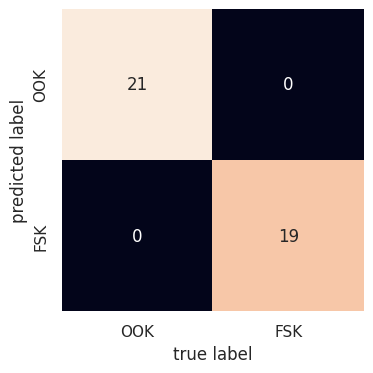

In [ ]:
sns.set()
mat = confusion_matrix(test_labels, predictions)
sns.heatmap(mat.T, square=True, annot=True, fmt='d', cbar=False, xticklabels=["OOK", "FSK"], yticklabels=["OOK", "FSK"])
plt.xlabel('true label')
plt.ylabel('predicted label')

## Neural Network: CNN 

Here we create label and generate normalized images in right order and we need to transform the labels to cat variables => thanks to One-Hot feature of Scikit lean :

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`)

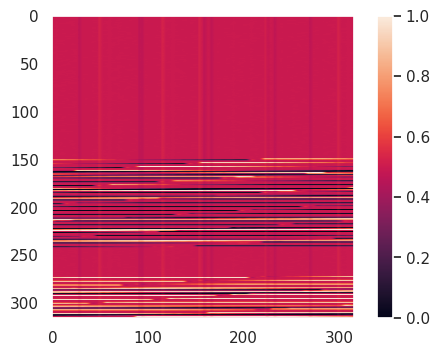

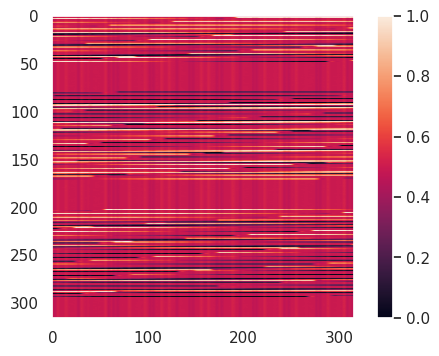

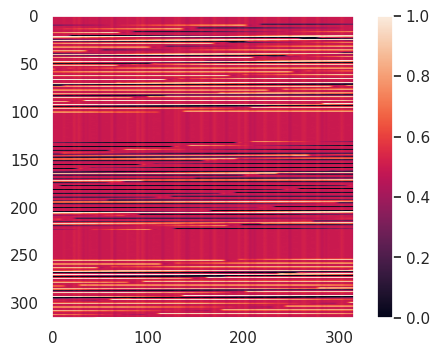

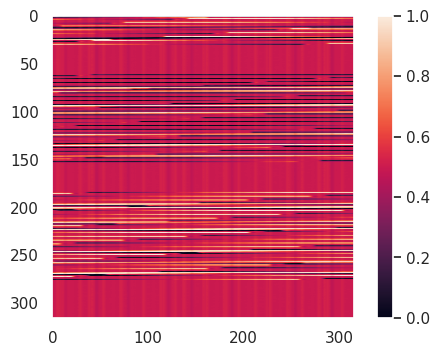

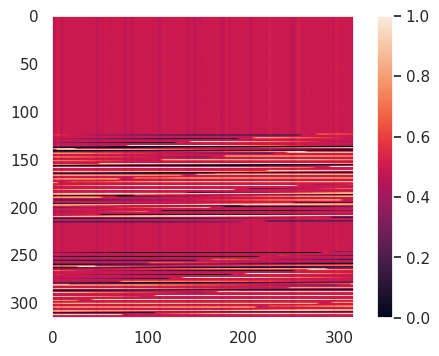

...

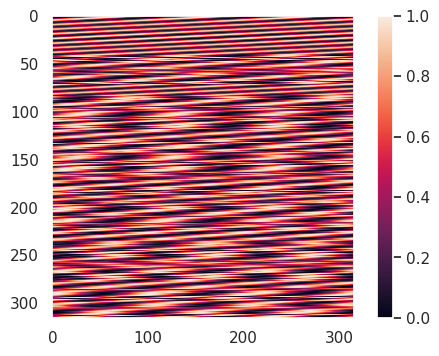

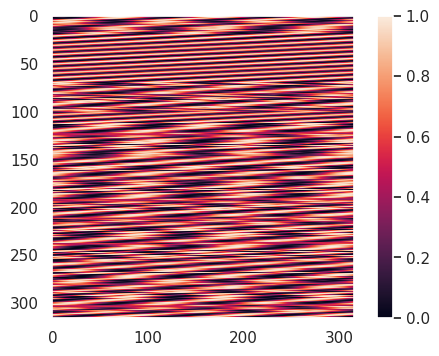

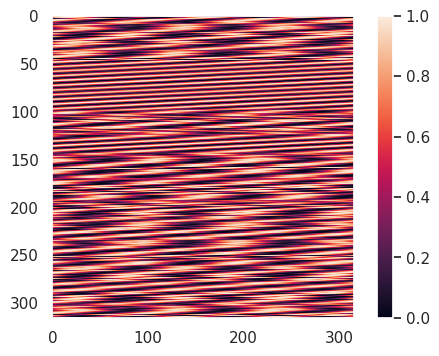

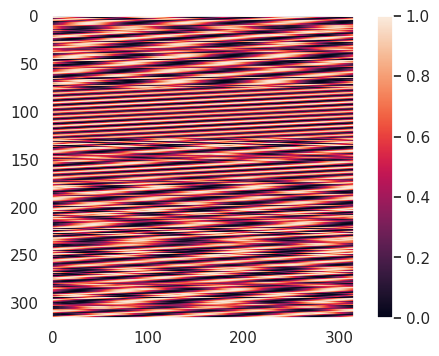

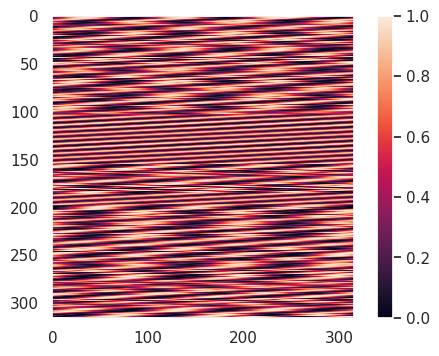

In [ ]:
#from keras.utils import to_categorical
from tensorflow.keras.utils import to_categorical

lenfsk = len(all_slices_fsk)
lenook = len(all_slices)

# taking using same weight for both
numsamplesmin = min(lenfsk, lenook) 
all_slices = all_slices[:numsamplesmin]

all_slices.extend(all_slices_fsk[:numsamplesmin]) # let's extend it all!

normalsignal = []
for tslice in all_slices:
    normalsignal.append(normalizeImg(tslice))

X = np.array(normalsignal) # forming our training set

# label creation
y_cnn = []
modtype = ["OOK","FSK"]

for i in range(len(modtype)):
  y_cnn += numsamplesmin*[i]
# to One-Hot
y_cnn = to_categorical(y_cnn)

x_cnn_train, x_cnn_test, y_cnn_train, y_cnn_test = train_test_split(X, y_cnn)

## Keras model

We can now write a simple version of a neural network as follows:

In [ ]:
from tensorflow import keras
import tensorflow as tf

model = keras.Sequential([
    keras.layers.Conv2D(64, activation='relu', kernel_size=3, input_shape=(316, 316, 1)),
    keras.layers.MaxPooling2D(pool_size=(2, 2)),
    keras.layers.Flatten(input_shape=(316, 316)), # 
    keras.layers.Dropout(0.3), # avoid overfitting by dropping with a prob of 30%
    keras.layers.Dense(64, activation=tf.nn.relu),
    keras.layers.Dense(len(modtype), activation=tf.nn.softmax)
])



In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 314, 314, 64)      640       
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 157, 157, 64)     0         
 2D)                                                             
                                                                 
 flatten_1 (Flatten)         (None, 1577536)           0         
                                                                 
 dropout_1 (Dropout)         (None, 1577536)           0         
                                                                 
 dense_1 (Dense)             (None, 64)                100962368 
                                                                 
 dense_2 (Dense)             (None, 2)                 130       
                                                        

We select the categorical crossentropy as a loss with the famous ADAM optimiser:

In [ ]:
model.compile(
    loss="categorical_crossentropy",
    optimizer="adam",
    metrics=["accuracy"]
)

Thr training can start:

In [ ]:
history = model.fit(x_cnn_train,
                    y_cnn_train,
                    epochs=25,
                    validation_data = (x_cnn_test,y_cnn_test))

Epoch 1/25
4/4 [==============================] - 19s 4s/step - loss: 60.6513 - accuracy: 0.4750 - val_loss: 79.2377 - val_accuracy: 0.4000
Epoch 2/25
4/4 [==============================] - 15s 4s/step - loss: 31.4611 - accuracy: 0.5500 - val_loss: 29.8672 - val_accuracy: 0.6000
Epoch 3/25
4/4 [==============================] - 15s 4s/step - loss: 29.7708 - accuracy: 0.4667 - val_loss: 4.6275 - val_accuracy: 0.6000
Epoch 4/25
4/4 [==============================] - 14s 4s/step - loss: 4.7317 - accuracy: 0.6000 - val_loss: 14.3722 - val_accuracy: 0.4000
Epoch 5/25
4/4 [==============================] - 14s 4s/step - loss: 7.9067 - accuracy: 0.5583 - val_loss: 2.7829 - val_accuracy: 0.6750
Epoch 6/25
4/4 [==============================] - 14s 4s/step - loss: 1.3029 - accuracy: 0.7500 - val_loss: 3.0619 - val_accuracy: 0.6000
Epoch 7/25
4/4 [==============================] - 15s 4s/step - loss: 1.8718 - accuracy: 0.5833 - val_loss: 0.3792 - val_accuracy: 0.9000
Epoch 8/25
4/4 [============

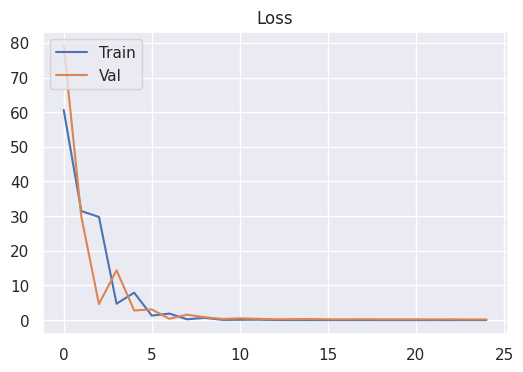

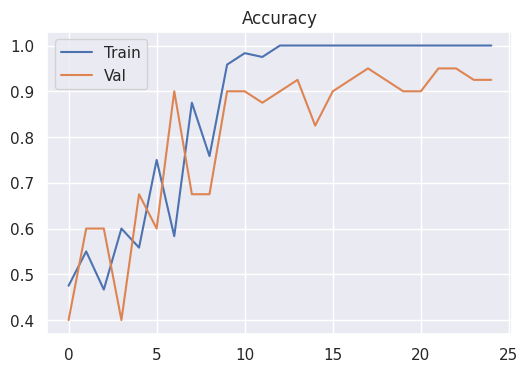

In [ ]:
loss_curve = history.history["loss"]
acc_curve = history.history["accuracy"]

loss_val_curve = history.history["val_loss"]
acc_val_curve = history.history["val_accuracy"]

plt.plot(loss_curve, label="Train")
plt.plot(loss_val_curve, label="Val")
plt.legend(loc='upper left')
plt.title("Loss")
plt.show()

plt.plot(acc_curve, label="Train")
plt.plot(acc_val_curve, label="Val")
plt.legend(loc='upper left')
plt.title("Accuracy")
plt.show()

In [ ]:
test_loss, test_acc = model.evaluate(x_cnn_test, y_cnn_test)
print('Accuracy on testdata:', test_acc * 100, "%")

2/2 [==============================] - 1s 224ms/step - loss: 0.1935 - accuracy: 0.9250
Accuracy on testdata: 92.5000011920929 %


The accurency depends on the data + training set but also the layers in our model. With noisy data, these layer 

At least, this example show how to start from raw real signals to be classified there after.